# Neighborhoods of Baltimore: People, Crime, and Venues

#### 4/09/2020, CJRR


## 1. Introduction: 

### 1.1: Objective: 
Characterize Baltimore’s neighborhoods in terms of their crime rates, age of the residents, population density, median household income, and venues. 

### 1.2: Background: 

**Client:** The principal client for this project is Jane New Resident.  She is a 38-year-old female professional who is moving to Baltimore. To start her house hunt, she is looking to identify low crime neighborhoods, with grocery stores, shops, restaurants and other professionals. 
  
**Baltimore:** Nick named “Charm City", Baltimore is the most populous city in Maryland. It is home to the world-renowned Johns Hopkins University and Hospital and numerous tourist destinations including the Pimilico Race Course, the Inner Harbor, and the Maryland Science Center.   However, crime in Baltimore is far above the national average and the city has a practically high murder rate. The city is divided into nine geographic regions and over 50 neighborhoods: each neighborhood having its own character. The city’s crime is generally concentrated in the neighborhoods with high rates of poverty.  

### 1.3. Analytic Approach: 

To help Jane select neighborhoods for her house hunt, this analysis will collect and generate summary data on the crime, number and type of venues, median income, age, and household size, for each neighborhood. It will then cluster the neighborhoodss, summarize each cluster and display the information in an interactive map. This will allow Janes to review the character of each cluster and selects a subset of neighborhoods to start searching in. 


## 2. Data: 
### 2.1 Data Requirements:
The analysis described in 1.3 will require the following data: 
-	List of the neighborhoods in Baltimore
-	The geographic boundaries of the neighborhood
-	General crime statistics for each neighborhood 
-	General demographic statistics for each neighborhood
-	Venue information for each neighborhood

The client wants to understand the general character of neighborhoods so she can start house hunting. She is worried about the crime rate. The analysis will need to include an overall picture of the crime rate of each neighborhood. 
She is looking to live near other like-professionals – a factor that is not easy to characterize. However demographic information may help identify those neighborhoods – specifically by examining the median income, the average household size, and the percentage of people that are in the 25 to 64-year-old age group. Because the crime rate is related to the high poverty areas, the analysis will include that as well.  

She is interested to understand the character of neighborhoods in term of the available shopping and restaurants.  For each neighborhood a listing of the type and number of nearby venues will be used. 

There are over 50 neighborhoods in Baltimore. The client wants to consider them in like character clusters so that she does not over-constrain her house-hunting options.

### 2.2 Data sources: 

#### 2.2.1 Crime and Safety:  
2015 Crime and Safety data for Baltimore City is available on Data.gov here: 

		https://catalog.data.gov/dataset/crime-and-safety-2015

This data set represent the year 2015’s values for Crime and Safety from Vital Signs published by the Baltimore Neighborhood Indicators Alliance. For more information, please visit http://www.bniajfi.org/vital_signs.  

The crime statistics are organized by neighborhood and includes the following features: 	
-	Part 1 Crime Rate per 1,000 Residents	
-	Violent Crime Rate per 1,000 Residents	
-	Property Crime Rate per 1,000 Residents	
-	Juvenile Arrest Rate per 1,000 Juveniles	
-	Juvenile Arrest Rate for Violent Offenses per 1,000 Juveniles	
-	Juvenile Arrest Rate for Drug Offenses per 1,000 Juveniles	
-	Rate of 911 Calls for Service for Shootings per 1,000 Residents	
-	Rate of Gun Homicides per 10,000 Residents	
-	Rate of 911 Calls for Service for Common Assaults per 1,000 Residents	
-	Rate of 911 Calls for Service for Narcotics per 1,000 Residents	
-	Rate of 911 Calls for Service for Auto Accidents per 1,000 Residents	
-	Adult Arrest Rate per 1,000 Adults	

For this analysis, of the above options, the following statistics will be included: 
-	Part 1 Crime Rate per 1,000 Residents	
-	Violent Crime Rate per 1,000 Residents	
-	Property Crime Rate per 1,000 Residents
Example:
 

####  2.2.2 Demographics:  
2015 Census demographics data for Baltimore City is available on Data.gov here: 

		https://catalog.data.gov/dataset/census-demographics-2015
        
This data set represents the year 2015’s values for Census Demographics from Vital Signs published by the Baltimore Neighborhood Indicators Alliance. For more information, please visit http://www.bniajfi.org/vital_signs.

The demographics statistics are organized by neighborhood and includes the following features: 	
-	Percent of Residents - Black/African-American	
-	Percent of Residents - White/Caucasian	Percent of Residents - Asian	
-	Percent of Residents - Two or More Races	
-	Percent of Residents - All Other Races	
-	Percent of Residents - Hispanic	Racial Diversity Index	
-	Percent of Population Under 5 Years Old	
-	Percent of Population 5-17 years old	
-	Percent of Population 18-24 years old	
-	Percent of Population 25-64 years old	
-	Percent of Population 65 years and over	
-	Total Number of Households	
-	Percent of Female-Headed Households with Children Under 18	
-	Percent of Households with Children Under 18	
-	Average Household Size
-	Median Household Income	
-	Percent of Households Earning Less than \\$25,000	
-	Percent of Households Earning \\$25,000 to \\$40,000	
-	Percent of Households Earning \\$40,000 to \\$60,000	
-	Percent of Households Earning \\$60,000 to \\$75,000	
-	Percent of Households Earning More than \\$75,000	
-	Percent of Family Households Living Below the Poverty Line	
-	Percent of Children Living Below the Poverty Line

For this analysis, of the above options, the following statistics will be included: 
-	Percent of Population 25-64 years old	
-	Average Household Size
-	Median Household Income
-	Percent of Family Households Living Below the Poverty Line
-	Total Number of Households – to calculate population density
  

#### 2.2.3 Neighborhoods and Boundaries:  
Both the demographics and crime data sets include a list of neighborhoods names and geographic boundaries. See below for a map of Baltimore Community Statistical Areas, hereafter referred to as neighborhoods, and the centroid of each neighborhood:
 
#### 2.2.4 Venues types and Counts:
Foursquares will be used to generate a list of venues near each neighborhood’s center. 	 


## 3. Methodology:

First lets import packages used in this notebook

In [1]:
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib 
import matplotlib.pyplot as plt  #used for plotting
import matplotlib.cm as cm 
import matplotlib.colors as colors
import folium  # used for maping maps 
import json # used to read geojson file
from pandas.io.json import json_normalize  # used to extract data from geojson file
#!conda install shapely
from shapely.geometry import Polygon  # used to calculate centriod see https://shapely.readthedocs.io/en/latest/manual.html#geometric-objects
import requests # used to query the foursquares api
from sklearn.preprocessing import StandardScaler # used to normalize data before clustering
from sklearn.cluster import KMeans # used for clustering 



### 3.1: Data Wrangling:

#### 3.1.1 Formatting and reformatting….

The 2015 crime and statistics and census data files posted on data.gov were a mess. The json files were not in a readable format. The CSV files had formatting inconsistencies. All the data was present, however to make it workable it had to be manually reformatted.  When completed there were three files, a CSV containing the crime and safety data, a CSV containing the census data, and a GEOJSON file containing multipolygon shapes for each neighborhood. The reformatted files are posted here:

	GEOJSON:
    
         https://github.com/AstroCris/CoureraCourses/blob/master/Baltimore44.geojson
         
    2015 Demographics: 
    
        https://github.com/AstroCris/CoureraCourses/blob/master/Census_Demographics__2015__data_clean.csv
        
	2015 Crime and Safety:
    
        https://github.com/AstroCris/CoureraCourses/blob/master/Crime_and_Safety__2015__data_clean.csv
        
#### 3.1.2 Reading and Slicing:


**GEOJSON:**

Simply reading the GEOJSON file and using Folium to produce a choropleth map produces the desired result. 
Each region the that corresponds to a neighborhood is colored. 

The color has no value in this example. 

The uncolored region in the center of the city, initially was a concern. 
However, that region corresponds to the city jail. 
The data sets do not include any crime or demographics information for this region, nor is it relevant to our house hunting client. 

Read GEOJSON

In [2]:
balt = r'Baltimore44.geojson'

Show regions on map

In [3]:
#Baltimore Lat Long: 
llat= 39.2904
long= -76.6122

In [4]:
mapG= folium.Map(location = [llat,long], zoom_start= 11)

mapG.choropleth(
    geo_data=balt,
    key_on='feature.properties.name',
    fill_opacity=0.3,
    )
mapG

**2015 Crime and Safety Data:**

Use pandas to read the reading the Crime and Safety CSV file

In [5]:
df= pd.read_csv('Crime_and_Safety__2015__data_clean.csv')
df.head()

,the_geom,OBJECTID,Community Statistical Areas (CSAs),"Part 1 Crime Rate per 1,000 Residents","Violent Crime Rate per 1,000 Residents","Property Crime Rate per 1,000 Residents","Juvenile Arrest Rate per 1,000 Juveniles","Juvenile Arrest Rate for Violent Offenses per 1,000 Juveniles","Juvenile Arrest Rate for Drug Offenses per 1,000 Juveniles","Rate of 911 Calls for Service for Shootings per 1,000 Residents","Rate of Gun Homicides per 10,000 Residents","Rate of 911 Calls for Service for Common Assaults per 1,000 Residents","Rate of 911 Calls for Service for Narcotics per 1,000 Residents","Rate of 911 Calls for Service for Auto Accidents per 1,000 Residents","Adult Arrest Rate per 1,000 Adults",Shape__Area,Shape__Length
0,NaN,1,Allendale/Irvington/S. Hilton,59.320466,15.045939,43.842881,21.177686,8.264463,1.549587,4.501449,0.924955,68.570019,51.674169,66.720109,21.873201,6.377046e+07,38770.16557
1,NaN,2,Beechfield/Ten Hills/West Hills,37.345075,7.909328,28.946510,3.793627,0.758725,0.000000,2.201566,0.407697,42.808219,21.689498,44.357469,9.129512,4.788253e+07,37524.95053
2,NaN,3,Belair-Edison,52.537896,11.770785,39.389068,24.112231,9.206488,0.876808,2.009646,0.516766,65.227377,24.919614,60.231971,20.798866,4.495003e+07,31307.31484
3,NaN,4,Brooklyn/Curtis Bay/Hawkins Point,61.644317,18.746051,42.266376,23.809524,5.602241,7.002801,4.282806,0.702099,132.415924,70.490767,69.367409,55.490196,1.760777e+08,150987.70190
4,MULTIPOLYGON (((-76.571398100367 39.2844148270...,5,Canton,51.234568,4.567901,46.543210,29.629630,0.000000,0.000000,0.370370,0.000000,29.135802,5.432099,57.283951,6.510763,1.540854e+07,23338.61248


The NaN entries in the "the_geom" column are entries where the multipolygon was corrupted in the CSV and were manually removed. Those entries were corrected manually in the GEOJSON file. 

Slice to the features of interest

In [6]:
keep = ['Community Statistical Areas (CSAs)' , 'Part 1 Crime Rate per 1,000 Residents','Violent Crime Rate per 1,000 Residents','Property Crime Rate per 1,000 Residents']
crime = df.loc[:,keep] 
crime.rename(columns={keep[0]: "hood", keep[1] : 'crime_rt', keep[2]: 'violet_rt', keep[3]: 'property_rt'}, inplace = True)
crime.head()

,hood,crime_rt,violet_rt,property_rt
0,Allendale/Irvington/S. Hilton,59.320466,15.045939,43.842881
1,Beechfield/Ten Hills/West Hills,37.345075,7.909328,28.946510
2,Belair-Edison,52.537896,11.770785,39.389068
3,Brooklyn/Curtis Bay/Hawkins Point,61.644317,18.746051,42.266376
4,Canton,51.234568,4.567901,46.543210


**2015 Demographics:**

Use pandas to read the 2015 Census CSV file 

In [7]:
df= pd.read_csv('Census_Demographics__2015__data_clean.csv')
df.head()

,the_geom,OBJECTID,Community Statistical Areas (CSAs),Percent of Residents - Black/African-American,Percent of Residents - White/Caucasian,Percent of Residents - Asian,Percent of Residents - Two or More Races,Percent of Residents - All Other Races,Percent of Residents - Hispanic,Racial Diversity Index,...,Median Household Income,"Percent of Households Earning Less than $25,000","Percent of Households Earning $25,000 to $40,000","Percent of Households Earning $40,000 to $60,000","Percent of Households Earning $60,000 to $75,000","Percent of Households Earning More than $75,000",Percent of Family Households Living Below the Poverty Line,Percent of Children Living Below the Poverty Line,Shape__Area,Shape__Length
0,NaN,1,Allendale/Irvington/S. Hilton,86.865672,8.955224,0.422886,2.151741,0.043532,1.560945,24.729153,...,36701.90674,36.069693,18.847378,16.786731,12.732451,15.563746,24.147122,38.931487,6.377046e+07,38770.16557
1,NaN,2,Beechfield/Ten Hills/West Hills,78.078191,15.443379,0.838826,2.366687,0.434392,2.838526,39.162063,...,51537.58208,20.384835,17.203277,20.956373,12.269004,29.186512,11.169652,19.416892,4.788253e+07,37524.95053
2,NaN,3,Belair-Edison,88.695385,8.849231,0.547692,0.947692,0.215385,0.744615,21.468088,...,38173.96825,34.950964,16.993575,17.906662,7.592154,22.556645,18.612071,36.882547,4.495003e+07,31307.31484
3,NaN,4,Brooklyn/Curtis Bay/Hawkins Point,37.597429,45.214002,1.374265,3.336524,1.148639,11.329140,69.857510,...,36679.05344,34.078212,19.393456,21.787710,9.517159,15.223464,28.359564,45.008801,1.760777e+08,150987.70190
4,MULTIPOLYGON (((-76.571398100367 39.2844148270...,5,Canton,2.459839,86.847390,3.790161,1.744478,0.238454,4.919679,26.293699,...,95362.40031,8.842850,8.716523,11.748358,7.377463,63.314805,2.998605,5.490849,1.540854e+07,23338.61248


The NaN entries in the "the_geom" column are entries where the multipolygon was corrupted in the CSVand were manually removed. Those entries were corrected manually in the GEOJSON file. 

Calculate population density per acre by multiplying the total number of households by the average household size and dividing by the area of the neighborhood. Multiplying the result by 43560 converts the result from 1/ft\^2  to 1/acres. 

In [8]:
#Calculate population density per acre 
df['Density'] = df['Total Number of Households']*df['Average Household Size'] / df['Shape__Area']*43560

Slice to the features of interest

In [9]:
keep = ['Community Statistical Areas (CSAs)','Percent of Population 25-64 years old','Average Household Size','Median Household Income','Percent of Family Households Living Below the Poverty Line', 'Density']
census = df.loc[:,keep] 
census.rename(columns={keep[0]: 'hood', keep[1]: "25-64_pct",  keep[2] : 'household_ave', keep[3]: 'income_median', keep[4]: 'pct_poverty', keep[5]: 'density'}, inplace = True)
census.head()

,hood,25-64_pct,household_ave,income_median,pct_poverty,density
0,Allendale/Irvington/S. Hilton,51.001244,2.670000,36701.90674,24.147122,10.886321
1,Beechfield/Ten Hills/West Hills,56.381067,2.550000,51537.58208,11.169652,12.176643
2,Belair-Edison,54.652308,2.762500,38173.96825,18.612071,15.832208
3,Brooklyn/Curtis Bay/Hawkins Point,56.413237,2.906667,36679.05344,28.359564,3.604041
4,Canton,73.958333,1.986667,95362.40031,2.998605,22.229373


#### 3.1.3 Neighborhoods Coordinates

The GEOJSON file contains the multipolygon shape of each neighborhood, expressed as a list of latitude and longitude coordinates.  However, the Foursquares API requires a single coordinate point (expressed as latitude and longitude) and a radius (in meters). 

The GEOJSON data should be sufficient to calculate reasonable center coordinates for each neighborhood.  As a first attempt the average of the latitudes and longitudes for each neighborhoods’ multipolygon was calculated. However, this produced erroneous results. Uncomment this to see the wrong results... 


In [10]:
#k=len(a['features'][0])
#Lats= np.zeros(k)
#Longs= np.zeros(k)
#locat= []

#for i in range(k):
#    LatTemp=0
#    LongTemp=0
#    t=len(a['features'][0][i]['geometry']['coordinates'][0][0])
#    for j in range(t):
#        LongTemp = LongTemp + a['features'][0][i]['geometry']['coordinates'][0][0][j][0]
#        LatTemp = LatTemp + a['features'][0][i]['geometry']['coordinates'][0][0][j][1]
#        LatMean= LatTemp/t
#        LongMean=LongTemp/t
#    print (a['features'][0][i]['properties']['name'], t, LatMean, LongMean)
#    Lats[i]= LatMean
#    Longs[i]=LongMean
#    locat.append(a['features'][0][i]['properties']['name'])
  

The above averaging method is biased by the density of points needed to define each edge. A more complicated edges requires more points to define it. This shifts the calculated average coordinates towards that edge. 

A more mathematically valid approach is to calculate the centroid of the polygon shape.  See https://en.wikipedia.org/wiki/Centroid for more information. The python library shapely has a function to do this. See https://shapely.readthedocs.io/en/latest/manual.html for more information.  

Using this function produced superior results: 


First read the file into a dataframe

In [11]:
with open('Baltimore44.geojson') as json_data:
    blt_data = json.load(json_data)
a= json_normalize(blt_data)

C:\Users\astro\anaconda3\lib\site-packages\ipykernel_launcher.py:3: FutureWarning: pandas.io.json.json_normalize is deprecated, use pandas.json_normalize instead
  This is separate from the ipykernel package so we can avoid doing imports until


Then calculate the centroid for each polygon

In [12]:
k=len(a['features'][0])
Lats= np.zeros(k)
Longs= np.zeros(k)
locat= []

for i in range(k):
    LatTemp=0
    LongTemp=0
    t=len(a['features'][0][i]['geometry']['coordinates'][0][0])
    poly = Polygon(a['features'][0][i]['geometry']['coordinates'][0][0])
    poly.centroid.coords[0][0]
    locat.append(a['features'][0][i]['properties']['name'])
    Lats[i]= poly.centroid.coords[0][1]
    Longs[i]=poly.centroid.coords[0][0]
    #print (locat[i], Lats[i], Longs[i])


Create a new dataframe containing the centroids

In [13]:
temp= {'index': locat , 'hood': locat, 'lat': Lats, 'long':Longs}
dfLatLong=pd.DataFrame(temp)
dfLatLong.set_index('index', inplace = True)
dfLatLong.head()

,hood,lat,long
index,,,
Greater Govans,Greater Govans,39.344454,-76.604296
Hamilton,Hamilton,39.351621,-76.547891
Sandtown-Winchester/Harlem Park,Sandtown-Winchester/Harlem Park,39.301178,-76.643323
Dorchester/Ashburton,Dorchester/Ashburton,39.331750,-76.677971
Howard Park/West Arlington,Howard Park/West Arlington,39.335560,-76.700687


Map with popups

In [14]:
#popups

mapNeigh= folium.Map(location = [llat,long], zoom_start= 11)

mapNeigh.choropleth(
    geo_data=balt,
    key_on='feature.properties.name',
    fill_opacity=0.0,
    )

for lat, lng, hood in zip(dfLatLong['lat'], dfLatLong['long'], dfLatLong['hood']):
    label = '{}'.format(hood)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=3,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(mapNeigh)  
    

mapNeigh


#### 3.1.3 Venue Data:

Foursquares was used to collect a list of venues details (name, location, category) for venues within  1000 meters of each neighborhoods’s centroid, up to 100 venues for each neighborhood.  Nearly 900 venues in over 200 unique categories are collected. 


Set API credentials

In [15]:
CLIENT_ID = 'AVXRZRL3A01BX2ZCDFJH0RE4UPDJIH4NWBGIHXSQUNRUVQAL' # your Foursquare ID
CLIENT_SECRET = 'DPZL54XHJUJSBMXY1QK2P44WOILQEO2BMCL1DU5O11OHZDP4' # your Foursquare Secret
VERSION = '20180605' # Foursquare API version

#print('Defining credentials:')
#print('CLIENT_ID: ' + CLIENT_ID)

Define function, from the labs, to query the Foursquares API iterativly for each neighborhoos

In [16]:
def getNearbyVenues(names, latitudes, longitudes, radius=500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            LIMIT)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['Neighborhood', 
                  'Neighborhood Latitude', 
                  'Neighborhood Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

Query Fousquares

In [17]:
LIMIT = 100 # limit of number of venues returned by Foursquare API
radius = 1000 # define radius in meters

print('Collecting information on:')
Venues = getNearbyVenues(names=dfLatLong['hood'],
                                   latitudes= dfLatLong['lat'],
                                   longitudes=dfLatLong['long']
                                  )


Greater Govans
Hamilton
Sandtown-Winchester/Harlem Park
Dorchester/Ashburton
Howard Park/West Arlington
Clifton-Berea
Patterson Park North & East
South Baltimore
Harbor East/Little Italy
Pimlico/Arlington/Hilltop
Chinquapin Park/Belvedere
Harford/Echodale
Westport/Mount Winans/Lakeland
Washington Village/Pigtown
Glen-Fallstaff
Oldtown/Middle East
Cherry Hill
Cedonia/Frankford
Madison/East End
Inner Harbor/Federal Hill
Downtown/Seton Hill
The Waverlies
Mount Washington/Coldspring
Highlandtown
Upton/Druid Heights
Poppleton/The Terraces/Hollins Market
Greenmount East
Midtown
Claremont/Armistead
Fells Point
Southern Park Heights
Orangeville/East Highlandtown
Southeastern
Canton
Southwest Baltimore
Midway/Coldstream
Greater Mondawmin
Cross-Country/Cheswolde
Penn North/Reservoir Hill
Allendale/Irvington/S. Hilton
Beechfield/Ten Hills/West Hills
Brooklyn/Curtis Bay/Hawkins Point
Dickeyville/Franklintown
Edmondson Village
Forest Park/Walbrook
Greater Charles Village/Barclay
Greater Roland Park

The result: 

In [18]:
print('A total of ', Venues.shape[0], 'venues were found. There are ', len(Venues['Venue Category'].unique()) , ' unigue catergories') 
Venues.head()

A total of  898 venues were found. There are  213  unigue catergories


,Neighborhood,Neighborhood Latitude,Neighborhood Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Greater Govans,39.344454,-76.604296,APlus at Sunoco,39.346470,-76.609390,Coffee Shop
1,Greater Govans,39.344454,-76.604296,Richwood Corner Store,39.346634,-76.607489,Snack Place
2,Greater Govans,39.344454,-76.604296,Chicken Run,39.345888,-76.609303,Fried Chicken Joint
3,Greater Govans,39.344454,-76.604296,Sudsville Laundry,39.345703,-76.598936,Laundromat
4,Greater Govans,39.344454,-76.604296,Weight Watchers,39.345101,-76.598681,Weight Loss Center


Lets see where they are: 

In [19]:
mapVenues= folium.Map(location = [llat,long], zoom_start= 11)

mapVenues.choropleth(
    geo_data=balt,
    key_on='feature.properties.name',
    fill_opacity=0.0,
    )

for lat, lng, vne in zip(Venues['Venue Latitude'], Venues['Venue Longitude'], Venues['Venue Category']):
    label = '{}'.format(vne)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=.5,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.7,
        parse_html=False).add_to(mapVenues)  
    

mapVenues

Some neighborhoods are pretty sparce. Played around with the search radius - it doesn't seem to help much. 

Since the objective is to characterize each neighborhood, the list of venues need to be translated into a summary for each neighborhood. First using one-hot-encoding the venue categories are converted into new columns and a ‘1’ is placed to indicate which category that venue is in. Zero is placed otherwise. 

In [20]:
# one hot encoding
Venues_onehot = pd.get_dummies(Venues[['Venue Category']], prefix="", prefix_sep="")
#Venues_onehot.drop(['Neighborhood'], axis = 1, inplace = True)

# add neighborhood column back to dataframe
Venues_onehot.insert(0, 'Neighborhood', Venues['Neighborhood']) 

Venues_onehot.tail()


,Neighborhood,ATM,Adult Boutique,Afghan Restaurant,American Restaurant,Antique Shop,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,...,Vietnamese Restaurant,Volleyball Court,Waterfall,Weight Loss Center,Whisky Bar,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yoga Studio
893,Greater Rosemont,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
894,Greater Rosemont,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
895,North Baltimore/Guilford/Homeland,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
896,North Baltimore/Guilford/Homeland,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
897,North Baltimore/Guilford/Homeland,0,0,0,0,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,0


.

Next the venues are grouped by neighborhood, summing the number of venues for each category: 


In [21]:
Venues_grouped = Venues_onehot.groupby('Neighborhood').sum().reset_index()
Venues_grouped.head()

,Neighborhood,ATM,Adult Boutique,Afghan Restaurant,American Restaurant,Antique Shop,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,...,Vietnamese Restaurant,Volleyball Court,Waterfall,Weight Loss Center,Whisky Bar,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yoga Studio
0,Allendale/Irvington/S. Hilton,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,Beechfield/Ten Hills/West Hills,1,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,Belair-Edison,0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
3,Brooklyn/Curtis Bay/Hawkins Point,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,Canton,0,0,0,3,0,0,0,0,0,...,1,0,0,0,0,0,1,0,0,0


Now the venue data is in a form that is relevant to the analysis objective. 

#### 3.1.4 Merging DataFrames

Merging the crime, census, and coordinates data frames to make a data frame for summary information: 


In [22]:
# Combining the Crime and Cenus data 
hood_merged = census
hood_merged = hood_merged.join(crime.set_index('hood'), on='hood')

In [23]:
# making a df with the lat long for summary data 
hood_summary = hood_merged.join(dfLatLong.set_index('hood'), on='hood')
hood_summary.head()

,hood,25-64_pct,household_ave,income_median,pct_poverty,density,crime_rt,violet_rt,property_rt,lat,long
0,Allendale/Irvington/S. Hilton,51.001244,2.670000,36701.90674,24.147122,10.886321,59.320466,15.045939,43.842881,39.284047,-76.678537
1,Beechfield/Ten Hills/West Hills,56.381067,2.550000,51537.58208,11.169652,12.176643,37.345075,7.909328,28.946510,39.288136,-76.702264
2,Belair-Edison,54.652308,2.762500,38173.96825,18.612071,15.832208,52.537896,11.770785,39.389068,39.321214,-76.574747
3,Brooklyn/Curtis Bay/Hawkins Point,56.413237,2.906667,36679.05344,28.359564,3.604041,61.644317,18.746051,42.266376,39.225856,-76.577810
4,Canton,73.958333,1.986667,95362.40031,2.998605,22.229373,51.234568,4.567901,46.543210,39.284285,-76.578654


Merging the crime, census and venues counts data frames to make a data frame that contains the relevant data for clustering: 

In [24]:
#creating a clustering data df for clustering 
hood_clustering = hood_merged.join(Venues_grouped.set_index('Neighborhood'), on='hood')
hood_clustering.head()

,hood,25-64_pct,household_ave,income_median,pct_poverty,density,crime_rt,violet_rt,property_rt,ATM,...,Vietnamese Restaurant,Volleyball Court,Waterfall,Weight Loss Center,Whisky Bar,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yoga Studio
0,Allendale/Irvington/S. Hilton,51.001244,2.670000,36701.90674,24.147122,10.886321,59.320466,15.045939,43.842881,0,...,0,0,0,0,0,0,0,0,0,0
1,Beechfield/Ten Hills/West Hills,56.381067,2.550000,51537.58208,11.169652,12.176643,37.345075,7.909328,28.946510,1,...,0,0,0,0,0,0,0,0,0,0
2,Belair-Edison,54.652308,2.762500,38173.96825,18.612071,15.832208,52.537896,11.770785,39.389068,0,...,0,0,0,0,0,0,0,0,0,0
3,Brooklyn/Curtis Bay/Hawkins Point,56.413237,2.906667,36679.05344,28.359564,3.604041,61.644317,18.746051,42.266376,0,...,0,0,0,0,0,0,0,0,0,0
4,Canton,73.958333,1.986667,95362.40031,2.998605,22.229373,51.234568,4.567901,46.543210,0,...,1,0,0,0,0,0,1,0,0,0


' 

Now all the data is collected and is in a usable form. :) Next up exploring the data:

### 3.2: Data Exploration:

Lets explore some of the data 

#### 3.2.1 Crime Rate:

How do the crime rates vary from neighborhood to neighborhood?


Text(0, 0.5, 'Crime rate per 1000 people')

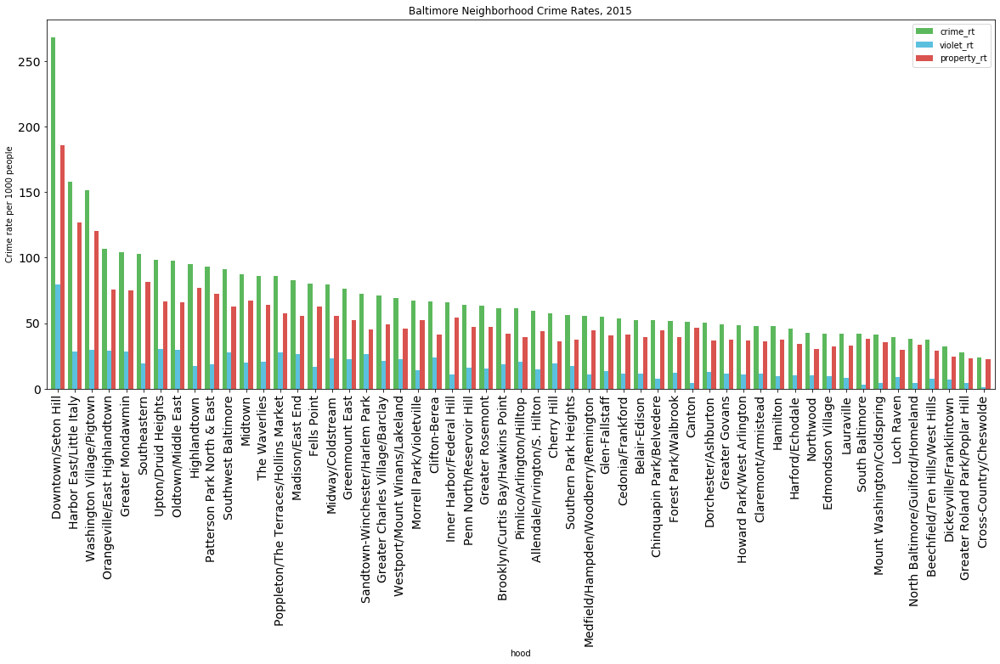

In [25]:
CmPlot= crime.sort_values(['crime_rt'], ascending=False, axis=0)
CmPlot.set_index('hood', inplace = True)
CmPlot.plot(kind='bar', figsize=(20, 8), color = ['#5cb85c','#5bc0de', '#d9534f' ], width=0.8,fontsize= '14')
plt.title('Baltimore Neighborhood Crime Rates, 2015')
plt.ylabel('Crime rate per 1000 people')


Geographically how do the crime rates vary?

In [26]:
mapC= folium.Map(location = [llat,long], zoom_start= 11)

mapC.choropleth(
    geo_data=balt,
    data=crime,
    columns=['hood','crime_rt'],
    key_on='feature.properties.name',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2, 
    legend_name='Total Crime Rate per 1000 people ',
)

mapC

In [27]:
# uncomment if you want to see this plot. I removed it because the file was too big... 

'''

mapCV= folium.Map(location = [llat,long], zoom_start= 11)

mapCV.choropleth(
    geo_data=balt,
    data=crime,
    columns=['hood','violet_rt'],
    key_on='feature.properties.name',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2, 
    legend_name='Violent Crime Rate per 1000 people ',
)

mapCV
'''

"\n\nmapCV= folium.Map(location = [llat,long], zoom_start= 11)\n\nmapCV.choropleth(\n    geo_data=balt,\n    data=crime,\n    columns=['hood','violet_rt'],\n    key_on='feature.properties.name',\n    fill_color='YlOrRd', \n    fill_opacity=0.7, \n    line_opacity=0.2, \n    legend_name='Violent Crime Rate per 1000 people ',\n)\n\nmapCV\n"

In [28]:
# uncomment if you want to see this plot. I removed it because the file was too big... 

'''

mapCP= folium.Map(location = [llat,long], zoom_start= 11)

mapCP.choropleth(
    geo_data=balt,
    data=crime,
    columns=['hood','property_rt'],
    key_on='feature.properties.name',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2, 
    legend_name='Property Crime Rate per 1000 people ',
)

mapCP
'''

"\n\nmapCP= folium.Map(location = [llat,long], zoom_start= 11)\n\nmapCP.choropleth(\n    geo_data=balt,\n    data=crime,\n    columns=['hood','property_rt'],\n    key_on='feature.properties.name',\n    fill_color='YlOrRd', \n    fill_opacity=0.7, \n    line_opacity=0.2, \n    legend_name='Property Crime Rate per 1000 people ',\n)\n\nmapCP\n"

#### 3.2.2 Census Bar Charts

How does each of the census features vary? 

Lets try bar charts:

In [29]:
#sort data by income then set index
CnPlot= census.sort_values(['income_median'], ascending=False, axis=0)
CnPlot.set_index('hood', inplace = True)

Text(0, 0.5, 'people/acre')

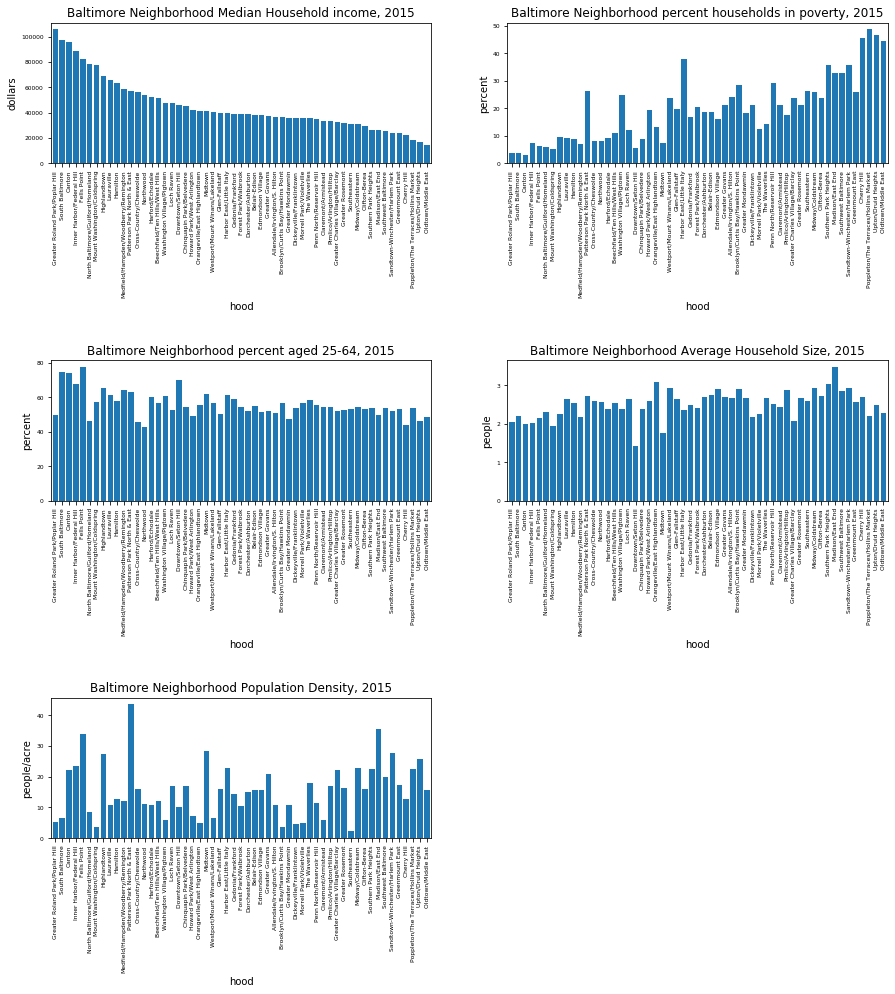

In [30]:
# make bar charts 

plt.subplot(521)
CnPlot['income_median'].plot(kind='bar', figsize=(15, 15), width=0.8,fontsize= '06')
plt.title('Baltimore Neighborhood Median Household income, 2015')
plt.ylabel('dollars')

plt.subplot(525)
CnPlot['25-64_pct'].plot(kind='bar', figsize=(15, 15), width=0.8,fontsize= '06')
plt.title('Baltimore Neighborhood percent aged 25-64, 2015')
plt.ylabel('percent')

plt.subplot(526)
CnPlot['household_ave'].plot(kind='bar', figsize=(15, 15), width=0.8,fontsize= '06')
plt.title('Baltimore Neighborhood Average Household Size, 2015')
plt.ylabel('people')

plt.subplot(522)
CnPlot['pct_poverty'].plot(kind='bar', figsize=(15, 15), width=0.8,fontsize= '06')
plt.title('Baltimore Neighborhood percent households in poverty, 2015')
plt.ylabel('percent')

plt.subplot(529)
CnPlot['density'].plot(kind='bar', figsize=(15, 15), width=0.8,fontsize= '06')
plt.title('Baltimore Neighborhood Population Density, 2015')
plt.ylabel('people/acre')


#### 3.2.3 Census Data choropleth
How does each of the census features vary?

Lets try choropleth:

**Median Income**

In [31]:
mapI= folium.Map(location = [llat,long], zoom_start= 11)

mapI.choropleth(
    geo_data=balt,
    data=census,
    columns=['hood','income_median'],
    key_on='feature.properties.name',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2, 
    legend_name='Median Income',
)

mapI

**Poverty**

In [32]:
mapPov= folium.Map(location = [llat,long], zoom_start= 11)

mapPov.choropleth(
    geo_data=balt,
    data=census,
    columns=['hood','pct_poverty'],
    key_on='feature.properties.name',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2, 
    legend_name='Percent Poverty ',
)

mapPov

**25 - 64 year olds**

In [33]:
# uncomment if you want to see this plot. I removed it because the file was too big... 

'''
map2564= folium.Map(location = [llat,long], zoom_start= 11)

map2564.choropleth(
    geo_data=balt,
    data=census,
    columns=['hood','25-64_pct'],
    key_on='feature.properties.name',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2, 
    legend_name='Percent Population 25 - 64 years old ',
)

map2564

'''

"\nmap2564= folium.Map(location = [llat,long], zoom_start= 11)\n\nmap2564.choropleth(\n    geo_data=balt,\n    data=census,\n    columns=['hood','25-64_pct'],\n    key_on='feature.properties.name',\n    fill_color='YlOrRd', \n    fill_opacity=0.7, \n    line_opacity=0.2, \n    legend_name='Percent Population 25 - 64 years old ',\n)\n\nmap2564\n\n"

**Average Household Size**

In [34]:
# uncomment if you want to see this plot. I removed it because the file was too big... 

'''
mapH= folium.Map(location = [llat,long], zoom_start= 11)

mapH.choropleth(
    geo_data=balt,
    data=census,
    columns=['hood','household_ave'],
    key_on='feature.properties.name',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2, 
    legend_name='Average Household Size ',
)

mapH

'''

"\nmapH= folium.Map(location = [llat,long], zoom_start= 11)\n\nmapH.choropleth(\n    geo_data=balt,\n    data=census,\n    columns=['hood','household_ave'],\n    key_on='feature.properties.name',\n    fill_color='YlOrRd', \n    fill_opacity=0.7, \n    line_opacity=0.2, \n    legend_name='Average Household Size ',\n)\n\nmapH\n\n"

**Population Density**

In [35]:
# uncomment if you want to see this plot. I removed it because the file was too big... 

'''
mapD= folium.Map(location = [llat,long], zoom_start= 11)

mapD.choropleth(
    geo_data=balt,
    data=census,
    columns=['hood','density'],
    key_on='feature.properties.name',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2, 
    legend_name='People / Acre',
)

mapD
'''

"\nmapD= folium.Map(location = [llat,long], zoom_start= 11)\n\nmapD.choropleth(\n    geo_data=balt,\n    data=census,\n    columns=['hood','density'],\n    key_on='feature.properties.name',\n    fill_color='YlOrRd', \n    fill_opacity=0.7, \n    line_opacity=0.2, \n    legend_name='People / Acre',\n)\n\nmapD\n"

### 3.3 Analysis

#### 3.3.1 Categorizing Statistical Data: 

To help analyze and interpret the crime and census numerical data for each neighborhood, lets  convert the numerical value for each feature to a categorical value of very low, low, moderate, high, or very high.  

The categorical value ‘very low’ is  assigned the lowest 10% of the features’ values, ‘low’ is  assigned to lowest 10-30% of values, moderate to the lowest 30-70%, high the lowest 70-90% , and very high >90% (equivalently, the highest 10%). 

The average house hold size is more sensical catergorised as mostly singles (<1.5), mostly couples (1.5 -2.5), mix couples and small families (2.5 - 3), and families (>3)

We will add this to the summmary dataframe.  Notice that we are saving the bins numerical ranges of the bins. We will use that later. 

In [36]:
# catergorizing all stats based on percentages, in one loop

cats = [ 'very low', 'low', 'moderate', 'high', 'very high']
cols = ['25-64_pct', 'household_ave', 'income_median', 'pct_poverty', 'density',
       'crime_rt', 'violet_rt', 'property_rt']
Bins = np.zeros([len(cols),6])

for j in range(len(cols)):
    Bins[j][:] = pd.qcut( hood_summary[cols[j]]  , q = [0, .1, .3, .7, .9, 1.] , retbins=True)[1]
    categories = pd.qcut( hood_summary[cols[j]]  , q = [0, .1, .3, .7, .9, 1.] , labels = cats)
    new_cols = cols[j] + '_cat'
    hood_summary.insert(j+1, new_cols, categories)    


In [37]:
#Fixing average household size   
categories = pd.cut( hood_summary['household_ave'], bins = [0, 1.5, 2.5, 3, 10], labels = ['mostly singles', 'mostly couples', 'couples & small families', 'families'])
hood_summary['household_ave_cat'] = categories
hood_summary

,hood,25-64_pct_cat,household_ave_cat,income_median_cat,pct_poverty_cat,density_cat,crime_rt_cat,violet_rt_cat,property_rt_cat,25-64_pct,household_ave,income_median,pct_poverty,density,crime_rt,violet_rt,property_rt,lat,long
0,Allendale/Irvington/S. Hilton,low,couples & small families,moderate,high,moderate,moderate,moderate,moderate,51.001244,2.670000,36701.90674,24.147122,10.886321,59.320466,15.045939,43.842881,39.284047,-76.678537
1,Beechfield/Ten Hills/West Hills,moderate,couples & small families,high,moderate,moderate,very low,low,very low,56.381067,2.550000,51537.58208,11.169652,12.176643,37.345075,7.909328,28.946510,39.288136,-76.702264
2,Belair-Edison,moderate,couples & small families,moderate,moderate,moderate,moderate,moderate,moderate,54.652308,2.762500,38173.96825,18.612071,15.832208,52.537896,11.770785,39.389068,39.321214,-76.574747
3,Brooklyn/Curtis Bay/Hawkins Point,moderate,couples & small families,moderate,high,very low,moderate,moderate,moderate,56.413237,2.906667,36679.05344,28.359564,3.604041,61.644317,18.746051,42.266376,39.225856,-76.577810
4,Canton,very high,mostly couples,very high,very low,high,moderate,very low,moderate,73.958333,1.986667,95362.40031,2.998605,22.229373,51.234568,4.567901,46.543210,39.284285,-76.578654
5,Cedonia/Frankford,high,couples & small families,moderate,moderate,moderate,moderate,moderate,moderate,59.014388,2.504000,39300.35503,16.856025,14.531271,53.572187,11.673812,41.473872,39.332612,-76.544728
6,Cherry Hill,very low,couples & small families,very low,very high,moderate,moderate,moderate,low,43.917574,2.696667,22403.36538,45.532995,12.599469,57.303097,19.385516,36.332602,39.249653,-76.623246
7,Chinquapin Park/Belvedere,moderate,mostly couples,moderate,low,moderate,moderate,low,moderate,54.572768,2.390000,45454.45455,8.852459,16.916769,52.475503,7.607014,44.739556,39.362939,-76.603778
8,Claremont/Armistead,moderate,mostly couples,low,moderate,low,low,moderate,low,54.524724,2.430000,33179.51103,21.266234,5.890224,48.110801,11.541732,35.840117,39.312681,-76.546306
9,Clifton-Berea,moderate,couples & small families,low,moderate,moderate,moderate,high,moderate,53.096398,2.716000,29364.20635,23.626062,16.126642,66.538384,23.698602,41.219364,39.309545,-76.583045


#### 3.3.2 Common Venues

To aid in characterizing each neighborhood, lets find out what are the most common venues in each neighborhood and write that into a new data frame, using the code from the labs


In [38]:
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)    
    return row_categories_sorted.index.values[0:num_top_venues]

In [39]:
num_top_venues = 7

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['Neighborhood']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
hoods_Venues_sorted = pd.DataFrame(columns=columns)
hoods_Venues_sorted['Neighborhood'] = Venues_grouped['Neighborhood']

for ind in np.arange(Venues_grouped.shape[0]):
       hoods_Venues_sorted.iloc[ind, 1:] = return_most_common_venues(Venues_grouped.iloc[ind, :], num_top_venues)

hoods_Venues_sorted.head()

,Neighborhood,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue
0,Allendale/Irvington/S. Hilton,Discount Store,Bus Stop,Karaoke Bar,Cosmetics Shop,Construction & Landscaping,Flower Shop,Thrift / Vintage Store
1,Beechfield/Ten Hills/West Hills,ATM,Residential Building (Apartment / Condo),Pool,Farm,Food Truck,Food Service,Food Court
2,Belair-Edison,Chinese Restaurant,Discount Store,American Restaurant,Food & Drink Shop,Convenience Store,Grocery Store,Pharmacy
3,Brooklyn/Curtis Bay/Hawkins Point,Food Truck,Yoga Studio,Frozen Yogurt Shop,French Restaurant,Food Service,Food Court,Food & Drink Shop
4,Canton,Bar,American Restaurant,Pizza Place,Gym / Fitness Center,Mexican Restaurant,Seafood Restaurant,Coffee Shop


Joining to the summary dataframe

In [40]:
hood_summary = hood_summary.join(hoods_Venues_sorted.set_index('Neighborhood'), on='hood')
hood_summary.head()

,hood,25-64_pct_cat,household_ave_cat,income_median_cat,pct_poverty_cat,density_cat,crime_rt_cat,violet_rt_cat,property_rt_cat,25-64_pct,...,property_rt,lat,long,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,6th Most Common Venue,7th Most Common Venue
0,Allendale/Irvington/S. Hilton,low,couples & small families,moderate,high,moderate,moderate,moderate,moderate,51.001244,...,43.842881,39.284047,-76.678537,Discount Store,Bus Stop,Karaoke Bar,Cosmetics Shop,Construction & Landscaping,Flower Shop,Thrift / Vintage Store
1,Beechfield/Ten Hills/West Hills,moderate,couples & small families,high,moderate,moderate,very low,low,very low,56.381067,...,28.946510,39.288136,-76.702264,ATM,Residential Building (Apartment / Condo),Pool,Farm,Food Truck,Food Service,Food Court
2,Belair-Edison,moderate,couples & small families,moderate,moderate,moderate,moderate,moderate,moderate,54.652308,...,39.389068,39.321214,-76.574747,Chinese Restaurant,Discount Store,American Restaurant,Food & Drink Shop,Convenience Store,Grocery Store,Pharmacy
3,Brooklyn/Curtis Bay/Hawkins Point,moderate,couples & small families,moderate,high,very low,moderate,moderate,moderate,56.413237,...,42.266376,39.225856,-76.577810,Food Truck,Yoga Studio,Frozen Yogurt Shop,French Restaurant,Food Service,Food Court,Food & Drink Shop
4,Canton,very high,mostly couples,very high,very low,high,moderate,very low,moderate,73.958333,...,46.543210,39.284285,-76.578654,Bar,American Restaurant,Pizza Place,Gym / Fitness Center,Mexican Restaurant,Seafood Restaurant,Coffee Shop


#### 3.3.3 Cluster Neighborhoods

Now lets use KMeans clustering to cluster the neighborhoods together. Because the fourquares is sparce in some neighborhoods, lets do this both with and without including the FourSquares data.

First we have to normalize the data, we'll use StandardScaler() 

In [41]:
X_noFS = hood_clustering.values[:,1:9] #slice to the not Fourquares data
X_FS = hood_clustering.values[:,1:] #slice all the data

X_noFS= StandardScaler().fit_transform(X_noFS) #normalize 
X_FS= StandardScaler().fit_transform(X_FS) #normalize 

Cluster the data without including the Foursquares.

This next cell has the cluster results from my initial analysis. Leave the next two cells as as they are to reporoduce my results in the report. 

In [42]:
# Hard coding  results, uncomment the next cell to   
clusterNum = 8
labels=[3, 6, 3, 0, 1, 3, 7, 6, 3, 3, 6, 3, 3, 2, 3, 1, 3, 3, 3, 3, 0, 6,
       3, 6, 6, 1, 3, 1, 6, 6, 5, 1, 5, 3, 6, 6, 6, 0, 5, 3, 3, 7, 5, 1,
       0, 5, 5, 0, 4, 0, 7, 4, 7, 1, 3]

This was the code that is used to cluster the data. Leave it commented to reproduce the results in my report, otherwise the cluster labels will change. If you want to play around with different number of cluster then uncomment and play :) 

In [43]:
'''
clusterNum = 8
k_means = KMeans(init = "k-means++", n_clusters = clusterNum, n_init = 12)
k_means.fit(X_noFS)
labels = k_means.labels_
print(labels)
'''

'\nclusterNum = 8\nk_means = KMeans(init = "k-means++", n_clusters = clusterNum, n_init = 12)\nk_means.fit(X_noFS)\nlabels = k_means.labels_\nprint(labels)\n'

In [44]:
hood_clustered_noFS = hood_clustering
hood_clustered_noFS['cluster'] = labels
#hood_clustered_noFS.set_index('hood', inplace = True)
#hood_clustered_noFS.head()
Clusters_noFS=hood_clustered_noFS.groupby('cluster').mean()

Group by the cluster number and take the mean of each feature

In [45]:
hood_clustered_noFS.groupby('cluster').mean()

,25-64_pct,household_ave,income_median,pct_poverty,density,crime_rt,violet_rt,property_rt,ATM,Adult Boutique,...,Vietnamese Restaurant,Volleyball Court,Waterfall,Weight Loss Center,Whisky Bar,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yoga Studio
cluster,,,,,,,,,,,,,,,,,,,,,
0,54.577119,2.812500,36864.873027,20.662509,7.711712,88.348843,23.099700,64.065607,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,69.367368,2.083786,76006.953610,6.380418,22.061153,68.199883,11.886277,55.742072,0.000000,0.142857,...,0.428571,0.142857,0.000000,0.000000,0.285714,0.285714,0.428571,0.000000,0.142857,0.142857
2,69.829190,1.436667,46132.866910,5.454545,10.312222,268.228359,79.429103,185.696556,0.000000,0.000000,...,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,53.329947,2.566620,35484.709813,20.650568,13.452264,56.218001,14.502281,40.950887,0.000000,0.000000,...,0.000000,0.000000,0.055556,0.055556,0.000000,0.000000,0.000000,0.055556,0.000000,0.000000
4,61.112011,2.377500,43536.526595,31.422385,14.434481,154.656080,29.049289,123.494436,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.500000,0.000000,0.000000,0.000000
5,54.262141,2.995458,31578.846760,31.609769,28.719827,79.285281,23.323529,54.783713,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,53.114143,2.420712,63439.270428,8.204275,11.327016,39.771567,6.968218,32.165119,0.090909,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.090909,0.000000,0.000000,0.000000,0.000000
7,48.160009,2.417458,18154.698775,46.321400,19.114445,84.790032,26.778533,56.705256,0.250000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.250000,0.000000,0.000000


In [46]:
hood_summary['cluster'] = labels

Now lets see how the clusters are distributed: 

In [47]:
# add  lat and long to the clustered results
hood_clustered_noFS= hood_clustered_noFS.join(dfLatLong.set_index('hood'), on='hood')

In [48]:
mapClusterNoFS= folium.Map(location = [llat,long], zoom_start= 11)

# set color scheme for the clusters
x = np.arange(clusterNum+1)
ys = [i + x + (i*x)**2 for i in range(clusterNum+1)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

mapClusterNoFS.choropleth(
    geo_data=balt,
    data=hood_clustered_noFS,
    columns=['hood','cluster'],
    key_on='feature.properties.name',
    fill_color='PuBu', 
    fill_opacity=0.7, 
    line_opacity=0.2, 
    legend_name='Cluster #',
    )

marker_colors=[]
for lat, lng, hood, cluster in zip(hood_clustered_noFS['lat'], hood_clustered_noFS['long'], hood_clustered_noFS['hood'],hood_clustered_noFS['cluster'] ):
    label = folium.Popup(str(hood) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=6,
        popup=label,
        color=rainbow[int(cluster)-1],
        fill=True,
        fill_color=rainbow[int(cluster)-1],
        fill_opacity=0.7).add_to(mapClusterNoFS)
       

mapClusterNoFS


In [49]:
# plot just one cluster: 
kclus=6 # the cluster number to plot 

hood_clustered_noFS0 = hood_clustered_noFS[hood_clustered_noFS['cluster']==kclus]

mapClusterNoFS0= folium.Map(location = [llat,long], zoom_start= 11)

# set color scheme for the clusters
x = np.arange(clusterNum+1)
ys = [i + x + (i*x)**2 for i in range(clusterNum+1)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

mapClusterNoFS0.choropleth(
    geo_data=balt,
    data=hood_clustered_noFS,
    columns=['hood','cluster'],
    key_on='feature.properties.name',
    fill_color='PuBu', 
    fill_opacity=0.7, 
    line_opacity=0.2, 
    legend_name='Cluster #',
    )

marker_colors=[]
for lat, lng, hood, cluster in zip(hood_clustered_noFS0['lat'], hood_clustered_noFS0['long'], hood_clustered_noFS0['hood'],hood_clustered_noFS0['cluster'] ):
    label = folium.Popup(str(hood) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=6,
        popup=label,
        color=rainbow[int(cluster)-1],
        fill=True,
        fill_color=rainbow[int(cluster)-1],
        fill_opacity=0.7).add_to(mapClusterNoFS0)
       

mapClusterNoFS0


##### Now clustering including the Foursquares data: 
Recall that we normalized the data already. 

In [50]:
clusterNum2 = 10
k_means = KMeans(init = "k-means++", n_clusters = clusterNum2, n_init = 12)
k_means.fit(X_FS)
labels = k_means.labels_
print(labels)

[0 0 0 0 4 0 0 0 0 0 0 0 0 2 0 1 0 0 0 0 0 0 0 0 0 8 0 6 0 0 0 5 0 0 0 0 0
 0 0 0 0 0 0 9 0 0 0 0 0 0 0 7 0 3 0]


In [51]:
hood_clustered_FS = hood_clustering
hood_clustered_FS['cluster'] = labels
#hood_clustered_FS.head()

Group by the cluster number and take the mean of each feature

In [52]:
Clusters_FS=hood_clustered_FS.groupby('cluster').mean()

Lets look at them:

In [53]:
# add  lat and long to the clustered results
hood_clustered_FS= hood_clustered_FS.join(dfLatLong.set_index('hood'), on='hood')

In [54]:
mapClusterFS= folium.Map(location = [llat,long], zoom_start= 11)

# set color scheme for the clusters
x = np.arange(clusterNum2+1)
ys = [i + x + (i*x)**2 for i in range(clusterNum2+1)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

mapClusterFS.choropleth(
    geo_data=balt,
    data=hood_clustered_FS,
    columns=['hood','cluster'],
    key_on='feature.properties.name',
    fill_color='PuBu', 
    fill_opacity=0.7, 
    line_opacity=0.2, 
    legend_name='Cluster',
    )

marker_colors=[]
for lat, lng, hood, cluster in zip(hood_clustered_FS['lat'], hood_clustered_FS['long'], hood_clustered_FS['hood'],hood_clustered_FS['cluster'] ):
    label = folium.Popup(str(hood) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=6,
        popup=label,
        color=rainbow[int(cluster)-1],
        fill=True,
        fill_color=rainbow[int(cluster)-1],
        fill_opacity=0.7).add_to(mapClusterFS)
       

mapClusterFS

The K-Means algorithm was run with different numbers of clusters and the results were visually inspected. In all cases the when the venue information was included, the alrgithm placed majority of neighborhoods in a single cluster. Such a result is not useful for the client. 

The best clustering result for the current objective is for 8 clusters and without using the venue information. 


#### 3.3.4 Summarizing Clusters

We alreaddy calacuated the mean values of each feature for the neighborhoods in each cluster. Let now catergorize, to help interperate. We are going to use the same Bins that we calcauated for the whole dataset. This ensures that ‘very high’ means a value that is among the top 10% of the value for all neighborhoods – and not the top 10% for values amongst the cluster means.  

In [55]:
# catergorizing all stats based on percentages, in one loop

cats = [ 'very low', 'low', 'moderate', 'high', 'very high']

for j in range(len(cols)):
    categories = pd.cut( Clusters_noFS[cols[j]]  , Bins[j][:], labels = cats)
    new_cols = cols[j] + '_cat'
    Clusters_noFS.insert(j, new_cols, categories)


In [56]:
#not fix the average household size
categories = pd.cut(Clusters_noFS['household_ave'], bins = [0, 1.5, 2.5, 3, 10], labels = ['mostly singles', 'mostly couples', 'couples & small families', 'families'])
Clusters_noFS['household_ave_cat'] = categories

Now lets look at the most common venues in each cluster, remember we did not use any venue information when clustering. 

In [57]:
temp = Clusters_noFS.iloc[:,16:]
vv=[]

for j in range(clusterNum):
    temp1=temp.iloc[j,:].sort_values(ascending = False)
    vv.append(temp1.index[:5].values)
    print(j, vv[j])


0 ['Discount Store' 'Coffee Shop' 'Tunnel' 'Bus Stop' 'Food Truck']
1 ['Bar' 'Pizza Place' 'Mexican Restaurant' 'American Restaurant'
 'Coffee Shop']
2 ['Café' 'Coffee Shop' 'Sandwich Place' 'Hotel' 'Food Truck']
3 ['Park' 'Fried Chicken Joint' 'Convenience Store' 'American Restaurant'
 'Chinese Restaurant']
4 ['Italian Restaurant' 'Pizza Place' 'Grocery Store' 'Bakery'
 'Rental Car Location']
5 ['Intersection' 'Grocery Store' 'Fast Food Restaurant' 'Park'
 'Gas Station']
6 ['Bus Stop' 'Flower Shop' 'Pharmacy' 'Coffee Shop' 'Farmers Market']
7 ['Pizza Place' 'Bus Stop' 'Fried Chicken Joint' 'Clothing Store' 'Market']


In [58]:
Clusters_noFS.insert(8, 'Top_5_Venues', vv )

In [59]:
Clusters_noFS

,25-64_pct_cat,household_ave_cat,income_median_cat,pct_poverty_cat,density_cat,crime_rt_cat,violet_rt_cat,property_rt_cat,Top_5_Venues,25-64_pct,...,Vietnamese Restaurant,Volleyball Court,Waterfall,Weight Loss Center,Whisky Bar,Wine Bar,Wine Shop,Wings Joint,Women's Store,Yoga Studio
cluster,,,,,,,,,,,,,,,,,,,,,
0,moderate,couples & small families,moderate,moderate,low,high,high,high,"[Discount Store, Coffee Shop, Tunnel, Bus Stop...",54.577119,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,very high,mostly couples,high,low,high,moderate,moderate,high,"[Bar, Pizza Place, Mexican Restaurant, America...",69.367368,...,0.428571,0.142857,0.000000,0.000000,0.285714,0.285714,0.428571,0.000000,0.142857,0.142857
2,very high,mostly singles,moderate,very low,low,very high,very high,very high,"[Café, Coffee Shop, Sandwich Place, Hotel, Foo...",69.829190,...,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
3,moderate,couples & small families,moderate,moderate,moderate,moderate,moderate,moderate,"[Park, Fried Chicken Joint, Convenience Store,...",53.329947,...,0.000000,0.000000,0.055556,0.055556,0.000000,0.000000,0.000000,0.055556,0.000000,0.000000
4,high,mostly couples,moderate,high,moderate,very high,very high,very high,"[Italian Restaurant, Pizza Place, Grocery Stor...",61.112011,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.500000,0.000000,0.000000,0.000000
5,moderate,couples & small families,low,high,very high,high,high,moderate,"[Intersection, Grocery Store, Fast Food Restau...",54.262141,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
6,moderate,mostly couples,high,low,moderate,very low,low,low,"[Bus Stop, Flower Shop, Pharmacy, Coffee Shop,...",53.114143,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.090909,0.000000,0.000000,0.000000,0.000000
7,low,mostly couples,very low,very high,high,high,high,high,"[Pizza Place, Bus Stop, Fried Chicken Joint, C...",48.160009,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.250000,0.000000,0.000000


Lets make cluster summary reports: 

In [60]:

print( clusterNum, ' clusters without considering the venue information')

for k in range(clusterNum):
    print( '\n\nCluster ', k , ':\n')
    print('Crime: ')
    print('   Crime:', Clusters_noFS.loc[k,'crime_rt_cat'], '; average rate is', Clusters_noFS.loc[k,'crime_rt'].round(1), 'per 1000 people')
    print('   Violent Crime:', Clusters_noFS.loc[k,'violet_rt_cat'], ', average rate is', Clusters_noFS.loc[k,'violet_rt'].round(1), 'per 1000 people')
    print('   Property Crime:', Clusters_noFS.loc[k,'property_rt_cat'], ', average rate is', Clusters_noFS.loc[k,'property_rt'].round(1), 'per 1000 people')
    
    print('\nPeople: ')
    print('   Median Income:', Clusters_noFS.loc[k,'income_median_cat'], ', average is', Clusters_noFS.loc[k,'income_median'].round(1), 'dollars per household')
    print('   Poverty:', Clusters_noFS.loc[k,'pct_poverty_cat'], ', average percentage of families in poverty is', Clusters_noFS.loc[k,'pct_poverty'].round(1))
    print('   Population Density:', Clusters_noFS.loc[k,'density_cat'], ', average population density is', Clusters_noFS.loc[k,'density'].round(1), 'people per acre')
    print('   25-64 age group:', Clusters_noFS.loc[k,'25-64_pct_cat'], ', average percentage of people in the 25-64 years age group is', Clusters_noFS.loc[k,'25-64_pct'].round(1))
    print('   Household Size:', Clusters_noFS.loc[k,'household_ave_cat'], ', average average household size is', Clusters_noFS.loc[k,'household_ave'].round(1), 'people')
    
    print('\nTop Venues:')
    for i in range(5):
        print('  ',Clusters_noFS.loc[k,'Top_5_Venues'][i])

    print('\nNeighborhoods:')
    df1 = hood_clustered_noFS[hood_clustered_noFS['cluster']==k].values
   
    for j in range(len(df1)):
        print('  ', df1[j][0])
        

8  clusters without considering the venue information


Cluster  0 :

Crime: 
   Crime: high ; average rate is 88.3 per 1000 people
   Violent Crime: high , average rate is 23.1 per 1000 people
   Property Crime: high , average rate is 64.1 per 1000 people

People: 
   Median Income: moderate , average is 36864.9 dollars per household
   Poverty: moderate , average percentage of families in poverty is 20.7
   Population Density: low , average population density is 7.7 people per acre
   25-64 age group: moderate , average percentage of people in the 25-64 years age group is 54.6
   Household Size: couples & small families , average average household size is 2.8 people

Top Venues:
   Discount Store
   Coffee Shop
   Tunnel
   Bus Stop
   Food Truck

Neighborhoods:
   Brooklyn/Curtis Bay/Hawkins Point
   Greater Mondawmin
   Orangeville/East Highlandtown
   Southeastern
   The Waverlies
   Westport/Mount Winans/Lakeland


Cluster  1 :

Crime: 
   Crime: moderate ; average rate is 68.2 p

## 4. Results:

###  4.1: Recomended Clusters

See the report for more details. In the my analysis - the best clusters were \#6, \#3, \#1  The following section will produce a report for each neigborhood in those clusters. If you played around with clustineing yourself this will give you a weird result. 

### 4.2 Recomended Neighborhoods

In [61]:
# plot just one cluster: 

clusterNum=8

hood_summary_Rec = hood_summary[(hood_summary['cluster'] ==1) |  (hood_summary['cluster'] ==3) | (hood_summary['cluster'] ==6 ) ] 

Results= folium.Map(location = [llat,long], zoom_start= 11)

# set color scheme for the clusters
x = np.arange(clusterNum+1)
ys = [i + x + (i*x)**2 for i in range(clusterNum+1)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

Results.choropleth(
    geo_data=balt,
    data=hood_summary_Rec,
    columns=['hood','cluster'],
    key_on='feature.properties.name',
    fill_color='PuBu', 
    fill_opacity=0.7, 
    line_opacity=0.2, 
    legend_name='Cluster #',
    )

marker_colors=[]
for lat, lng, hood, cluster in zip(hood_summary_Rec['lat'], hood_summary_Rec['long'], hood_summary_Rec['hood'],hood_summary_Rec['cluster'] ):
    label = folium.Popup(str(hood) + ' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=6,
        popup=label,
        color=rainbow[int(cluster)-1],
        fill=True,
        fill_color=rainbow[int(cluster)-1],
        fill_opacity=0.7).add_to(Results)
       

Results

In [62]:
rec=hood_summary_Rec.sort_values(by = ['cluster'], ascending = False)


In [63]:
print ('A total of',len(rec),'neighborhoods are recommended for consideration.\n')

for k in rec.index:
    print(rec.loc[k,'hood'],':')
    print('Cluster:', rec.loc[k,'cluster'])
    print('Crime: ')
    print('   Crime:', rec.loc[k,'crime_rt_cat'], ', ',rec.loc[k,'crime_rt'].round(1), 'per 1000 people')
    print('   Violent Crime:', rec.loc[k,'violet_rt_cat'], ', ', rec.loc[k,'violet_rt'].round(1), 'per 1000 people')
    print('   Property Crime:', rec.loc[k,'property_rt_cat'], ', ', rec.loc[k,'property_rt'].round(1), 'per 1000 people')
    
    print('People: ')
    print('   Median Income:', rec.loc[k,'income_median_cat'], ', ',rec.loc[k,'income_median'].round(1), 'dollars per household')
    print('   Poverty:', rec.loc[k,'pct_poverty_cat'], ', percentage of families in poverty is', rec.loc[k,'pct_poverty'].round(1))
    print('   Population Density:', rec.loc[k,'density_cat'], ', population density is', rec.loc[k,'density'].round(1), 'people per acre')
    print('   25-64 age group:', rec.loc[k,'25-64_pct_cat'], ', percentage population is', rec.loc[k,'25-64_pct'].round(1))
    print('   Household Size:', rec.loc[k,'household_ave_cat'], ', average household size is', rec.loc[k,'household_ave'].round(1), 'people')
    
    print('Top Venues:')
    print(' ',rec.loc[k,'1st Most Common Venue'])
    print(' ',rec.loc[k,'2nd Most Common Venue'])    
    print(' ',rec.loc[k,'3rd Most Common Venue'])    
    print(' ',rec.loc[k,'4th Most Common Venue'])    
    print(' ',rec.loc[k,'5th Most Common Venue'])
    print(' ',rec.loc[k,'6th Most Common Venue'])    
    print(' ',rec.loc[k,'7th Most Common Venue'], '\n\n')    
    


A total of 36 neighborhoods are recommended for consideration.

Greater Roland Park/Poplar Hill :
Cluster: 6
Crime: 
   Crime: very low ,  27.9 per 1000 people
   Violent Crime: very low ,  4.2 per 1000 people
   Property Crime: very low ,  23.5 per 1000 people
People: 
   Median Income: very high ,  105555.3 dollars per household
   Poverty: very low , percentage of families in poverty is 3.8
   Population Density: low , population density is 5.2 people per acre
   25-64 age group: low , percentage population is 49.9
   Household Size: mostly couples , average household size is 2.0 people
Top Venues:
  Bank
  Flower Shop
  Grocery Store
  Coffee Shop
  Yoga Studio
  French Restaurant
  Food Truck 


Northwood :
Cluster: 6
Crime: 
   Crime: low ,  42.3 per 1000 people
   Violent Crime: low ,  10.5 per 1000 people
   Property Crime: very low ,  30.6 per 1000 people
People: 
   Median Income: high ,  53974.3 dollars per household
   Poverty: low , percentage of families in poverty is 8.0

   Violent Crime: moderate ,  17.4 per 1000 people
   Property Crime: very high ,  76.8 per 1000 people
People: 
   Median Income: high ,  68702.2 dollars per household
   Poverty: low , percentage of families in poverty is 9.6
   Population Density: very high , population density is 27.4 people per acre
   25-64 age group: very high , percentage population is 65.6
   Household Size: mostly couples , average household size is 2.3 people
Top Venues:
  New American Restaurant
  Dive Bar
  Pizza Place
  Mexican Restaurant
  Gym / Fitness Center
  Hot Dog Joint
  Business Service 


Canton :
Cluster: 1
Crime: 
   Crime: moderate ,  51.2 per 1000 people
   Violent Crime: very low ,  4.6 per 1000 people
   Property Crime: moderate ,  46.5 per 1000 people
People: 
   Median Income: very high ,  95362.4 dollars per household
   Poverty: very low , percentage of families in poverty is 3.0
   Population Density: high , population density is 22.2 people per acre
   25-64 age group: very high , pe